## 1. Import Library & Read Dataset Image

In [1]:
# %conda install panda
# %conda install matplotlib
# %conda install seaborn
# %conda install sklearn
# %conda install PIL
# %conda install cv2

In [2]:
# import beberapa library yang akan dibutuhkan
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report
from PIL import Image
from sklearn.model_selection import train_test_split
import cv2
from glob import glob
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, GlobalAveragePooling2D
from tensorflow.keras.models import Sequential

In [3]:
# Memanggil semua data gambar dengan keempat kategori yang berbeda yang ada di dalam folder COVID-19_Radiography_Dataset
covid19_images_data = "TestDataset/COVID"
lung_opacity_images_data = "TestDataset/Lung_Opacity"
normal_images_data = "TestDataset/Normal"
pneumonia_images_data = "TestDataset/Viral Pneumonia"

In [4]:
"""
Memanggil semua gambar dengan seluruh eksistensi gambar (.png/.jpg/.jpeg) yang ada
di dalam keempat DataFrame yang menampung data-data gambar berdasarkan kategorinya
"""
# Data gambar paru-paru manusia yang terkena virus covid-19
covid19_data = glob(covid19_images_data + "/*")

# Data gambar paru-paru dengan kategori penyakit yaitu lung opacity
lung_opacity_data = glob(lung_opacity_images_data + "/*")

# Data gambar dengan kategori paru-paru normal
normal_data = glob(normal_images_data + "/*")

# Data gambar dengan penyakit paru-paru denga kategori pneumonia
pneumonia_data = glob(pneumonia_images_data + "/*")

Keterangan:

Pada script diatas terdapat code dengan "/*" yang menandakan untuk mencocokan segala jenis eksistensi file yang ada di dalam folder tersebut untuk dipanggil ke dalam code. Sebagai contoh jika kita ingin hanya memanggil file dengan eksistensi .txt maka bisa gunakan script "/*.txt" atau jika ingin memanggil file yang hanya bereksistensi .jpg (karena pada eksperimen kali ini menggunakan data images) maka kita bisa menggunakan script "/*.jpg".

In [5]:
# Melihat jumlah masing-masing data gambar dari keempat kategori paru-paru (normal, covid-19, lung opacity atau pneumonia)
print("Nama Ketiga File dari Gambar Covid-19: ", covid19_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Covid-19: ", len(covid19_data), "\n")

print("Nama Ketiga File dari Gambar Lung Opacity: ", lung_opacity_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity: ", len(lung_opacity_data), "\n")

print("Nama Ketiga File dari Gambar Normal: ", normal_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Normal: ", len(normal_data), "\n")

print("Nama Ketiga File dari Gambar Pneumonia: ", pneumonia_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Pneumonia: ", len(pneumonia_data))

Nama Ketiga File dari Gambar Covid-19:  ['TestDataset/COVID\\COVID-1.png', 'TestDataset/COVID\\COVID-10.png', 'TestDataset/COVID\\COVID-11.png']
Jumlah Data pada Kategori Gambar Paru-Paru Covid-19:  50 

Nama Ketiga File dari Gambar Lung Opacity:  ['TestDataset/Lung_Opacity\\Lung_Opacity-1.png', 'TestDataset/Lung_Opacity\\Lung_Opacity-10.png', 'TestDataset/Lung_Opacity\\Lung_Opacity-11.png']
Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity:  50 

Nama Ketiga File dari Gambar Normal:  ['TestDataset/Normal\\Normal-1.png', 'TestDataset/Normal\\Normal-10.png', 'TestDataset/Normal\\Normal-11.png']
Jumlah Data pada Kategori Gambar Paru-Paru Normal:  50 

Nama Ketiga File dari Gambar Pneumonia:  ['TestDataset/Viral Pneumonia\\Viral Pneumonia-1.png', 'TestDataset/Viral Pneumonia\\Viral Pneumonia-10.png', 'TestDataset/Viral Pneumonia\\Viral Pneumonia-11.png']
Jumlah Data pada Kategori Gambar Paru-Paru Pneumonia:  50


In [6]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu Normal dan Pneumonia
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Normal"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------")

# Gambar x-ray dengan urutan file ke-1.798
normal_img1798_resolution = Image.open(str(normal_data[33]))
width, height = normal_img1798_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-1.001
normal_img1001_resolution = Image.open(str(normal_data[22]))
width, height = normal_img1001_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-862
normal_img862_resolution = Image.open(str(normal_data[11]))
width, height = normal_img862_resolution.size

print("Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Pneumonia"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------")

# Gambar x-ray 377
pneumonia_img377_resolution = Image.open(str(pneumonia_data[11]))
width, height = pneumonia_img377_resolution.size

print("Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 784
pneumonia_img784_resolution = Image.open(str(pneumonia_data[22]))
width, height = pneumonia_img784_resolution.size

print("Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 1.008
pneumonia_img1008_resolution = Image.open(str(pneumonia_data[44]))
width, height = pneumonia_img1008_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------
Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------
Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah: 299x299


In [7]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu covid-19 dan Lung Opacity
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Covid-19"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------")

# Gambar x-ray pertama
covid19_img1_resolution = Image.open(str(covid19_data[0]))
width, height = covid19_img1_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-53
covid19_img53_resolution = Image.open(str(covid19_data[11]))
width, height = covid19_img53_resolution.size

print("Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-67
covid19_img67_resolution = Image.open(str(covid19_data[22]))
width, height = covid19_img67_resolution.size

print("Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Lung Opacity"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------")

# Gambar x-ray kelima
lungopacity_img5_resolution = Image.open(str(lung_opacity_data[33]))
width, height = lungopacity_img5_resolution.size

print("Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 39
lungopacity_img39_resolution = Image.open(str(lung_opacity_data[39]))
width, height = lungopacity_img39_resolution.size

print("Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 119
lungopacity_img119_resolution = Image.open(str(lung_opacity_data[45]))
width, height = lungopacity_img119_resolution.size

print("Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------
Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------
Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah: 299x299


## 2. Eksplorasi Data Gambar berdasarkan Keempat Kategori dari Paru-Paru

### 2.1. Menampilkan Salah Satu Gambar dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.1.1. Gambar X-Ray Paru-Paru Covid-19

TestDataset/COVID\COVID-1.png


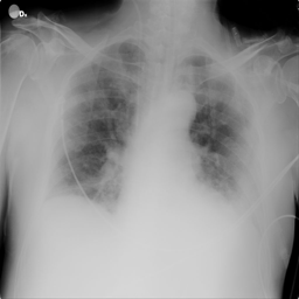

In [8]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena virus covid-19
covid_image = list(covid19_data)
print(covid_image[0])

# Membuka gambar dengan indeks array pertama atau dengan kata lain melihat gambar pertama dari paru-paru covid-19
Image.open(str(covid_image[0]))

#### 2.1.2. Gambar X-Ray Paru-Paru Lung Opacity

TestDataset/Lung_Opacity\Lung_Opacity-12.png


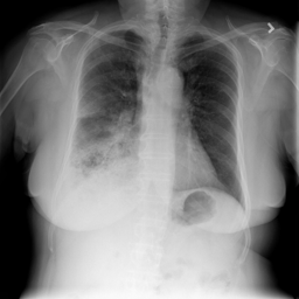

In [9]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit lung opacity
lung_opacity_image = list(lung_opacity_data)
print(lung_opacity_image[3])

"""
Membuka gambar dengan indeks array ketiga dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar keempat dari paru-paru yang terindikasi penyakit dengan kategori lung opacity
"""
Image.open(str(lung_opacity_image[3]))

#### 2.1.3. Gambar X-Ray Paru-Paru Normal

TestDataset/Normal\Normal-15.png


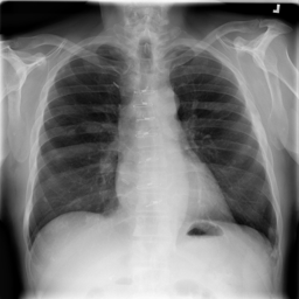

In [10]:
"""
Menampilkan salah satu gambar dari paru-paru normal
(yang tidak terindikasi penyakit apapun seperti covid-19/lung opacity dan pneumonia)
"""
normal_lung_image = list(normal_data)
print(normal_lung_image[6])

"""
Membuka gambar dengan indeks array keenam dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ketujuh dari paru-paru yang memliki kategori normal
"""
Image.open(str(normal_lung_image[6]))

#### 2.1.4. Gambar X-Ray Paru-Paru Pneumonia

TestDataset/Viral Pneumonia\Viral Pneumonia-27.png


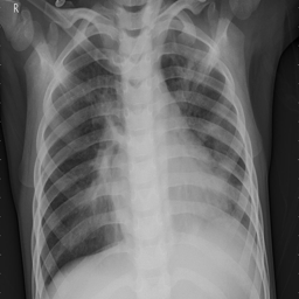

In [11]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit pneumonia
pneumonia_lung_image = list(pneumonia_data)
print(pneumonia_lung_image[19])

"""
Membuka gambar dengan indeks array 19 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ke-20 dari paru-paru yang terindikasi penyakit dengan kategori pneumonia
"""
Image.open(str(pneumonia_lung_image[19]))

### 2.2. Menampilkan Beberapa Gambar yang Membentuk Horizontal (Berdasarkan Baris) dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.2.1 Kumpulan Gambar dari Data X-Ray Covid-19

Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: 


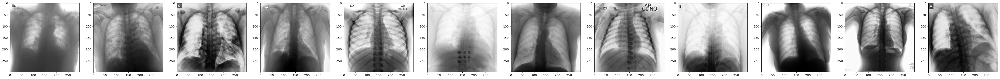

In [12]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi covid-19 dengan cara melakukan perulangan
for covid in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: ")
    covid = list(covid19_data)
    covid_path = [k for k in covid19_data]
    
    for i in range (12):
        covid_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(covid_path[i], color_mode="grayscale"))
        axs[i].imshow(covid_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for covid in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru terkena covid. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru covid-19 dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "covid" yang berisikan list dari variabel "covid19_data" memiliki tujuan yaitu variabel "covid" mengambil semua isi data yang ada di dalam variabel "covid19_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "covid_path" terkoneksi atau sangat berkaitan dengan variabel "covid_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.2. Kumpulan Gambar dari Data X-Ray Lung Opacity

Kumpulan Gambar Paru-Paru yang Lung Opacity: 


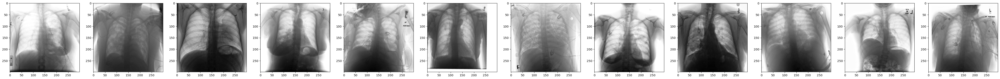

In [13]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi lung opacity dengan cara melakukan perulangan
for lung_opacity in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Lung Opacity: ")
    lungopacity = list(lung_opacity_data)
    lungopacity_path = [k for k in lung_opacity_data]
    
    for i in range (12):
        lung_opacity_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(lungopacity_path[i], color_mode="grayscale"))
        axs[i].imshow(lung_opacity_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for lung_opacity in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru lung opacity. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru lung opacity dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "lungopacity" yang berisikan list dari variabel "lung_opacity_data" memiliki tujuan yaitu variabel "lungopacity" mengambil semua isi data yang ada di dalam variabel "lung_opacity_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "lungopacity_path" terkoneksi atau sangat berkaitan dengan variabel "lung_opacity_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.3. Kumpulan Gambar dari Data X-Ray Normal

Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus atau Penyakit): 


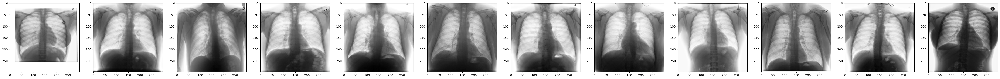

In [14]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang normal (tidak terkena apapun) dengan cara melakukan perulangan
for normal in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus atau Penyakit): ")
    normal = list(normal_data)
    normal_path = [k for k in normal_data]
    
    for i in range (12):
        normal_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(normal_path[i], color_mode="grayscale"))
        axs[i].imshow(normal_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for normal in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru normal. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru normal dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "normal" yang berisikan list dari variabel "normal_data" memiliki tujuan yaitu variabel "normal" mengambil semua isi data yang ada di dalam variabel "normal_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "normal_path" terkoneksi atau sangat berkaitan dengan variabel "normal_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.4. Kumpulan Gambar dari Data X-Ray Pneumonia

Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia: 


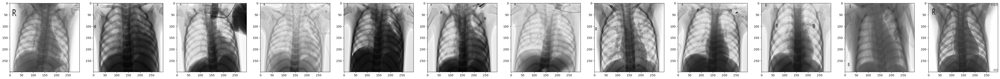

In [15]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi penyakit pneumonia dengan cara melakukan perulangan
for pneumonia in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia: ")
    pneumonia = list(pneumonia_data)
    pneumonia_path = [k for k in pneumonia_data]
    
    for i in range (12):
        pneumonia_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(pneumonia_path[i], color_mode="grayscale"))
        axs[i].imshow(pneumonia_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for pneumonia in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru pneumonia. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru pneumonia dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "pneumonia" yang berisikan list dari variabel "pneumonia_data" memiliki tujuan yaitu variabel "pneumonia" mengambil semua isi data yang ada di dalam variabel "pneumonia_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "pneumonia_paths" terkoneksi atau sangat berkaitan dengan variabel "pneumonia_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

### 2.3. Menampilkan 35 Gambar Hasil X-Ray Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.3.1. Gambar X-Ray dari Paru-Paru dengan Status Covid-19

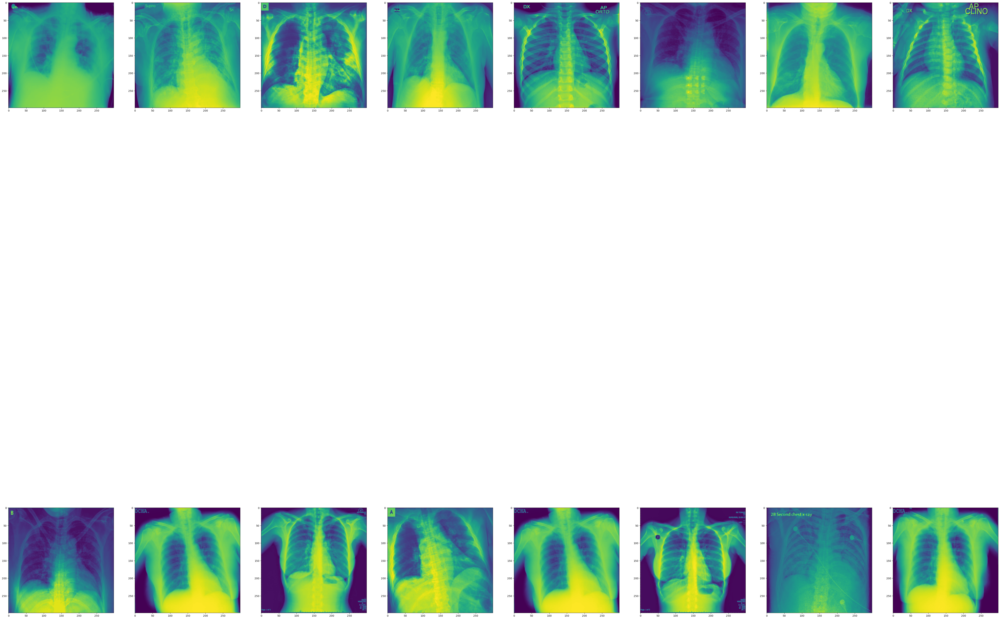

In [16]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena virus covid-19
fig = plt.figure(figsize=(70, 66))

rows = 2 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_covid_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_covid_images + 1)
    images = plt.imread(covid19_data[multiple_covid_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.2. Gambar X-Ray dari Paru-Paru dengan Status Long Opacity

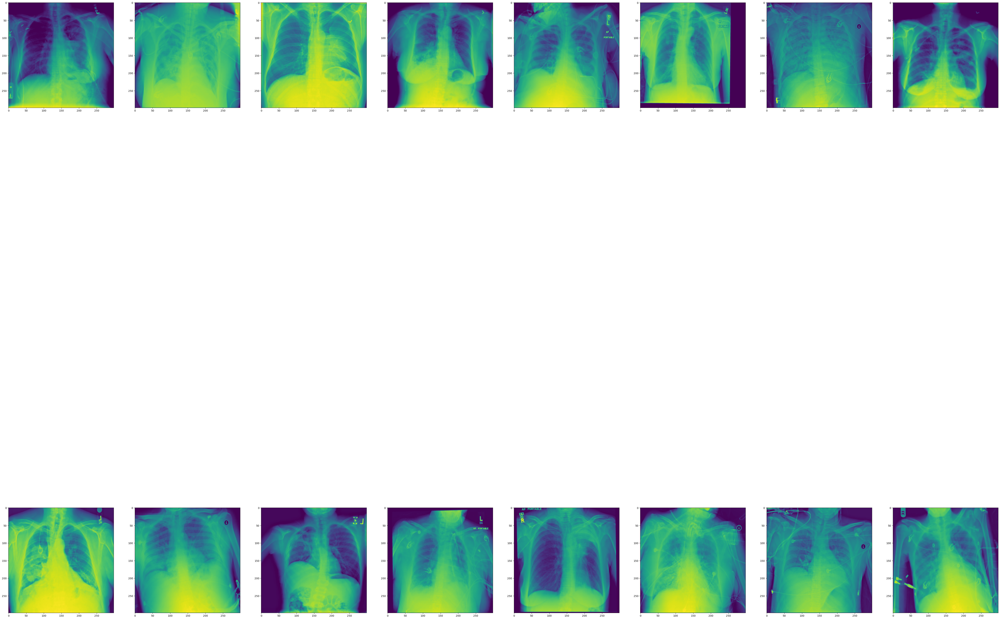

In [17]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena lung opacity
fig = plt.figure(figsize=(70, 66))

rows = 2 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_lung_opacity_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_lung_opacity_images + 1)
    images = plt.imread(lung_opacity_data[multiple_lung_opacity_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.3. Gambar X-Ray dari Paru-Paru dengan Status Normal

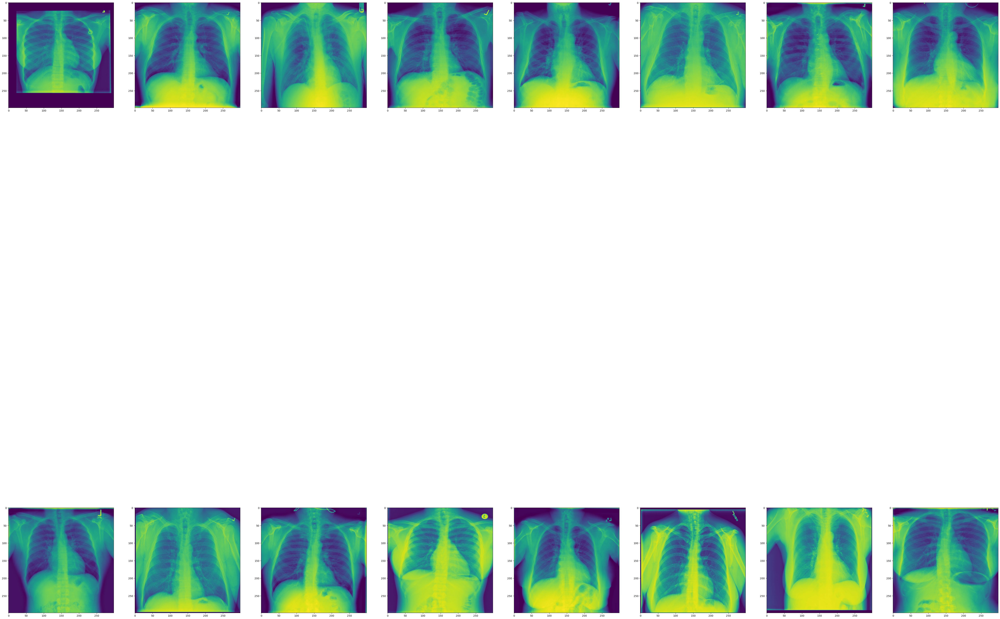

In [18]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru dengan status/kategori normal
fig = plt.figure(figsize=(70, 66))

rows = 2 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_normal_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_normal_images + 1)
    images = plt.imread(normal_data[multiple_normal_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.4. Gambar X-Ray dari Paru-Paru dengan Status Pneumonia

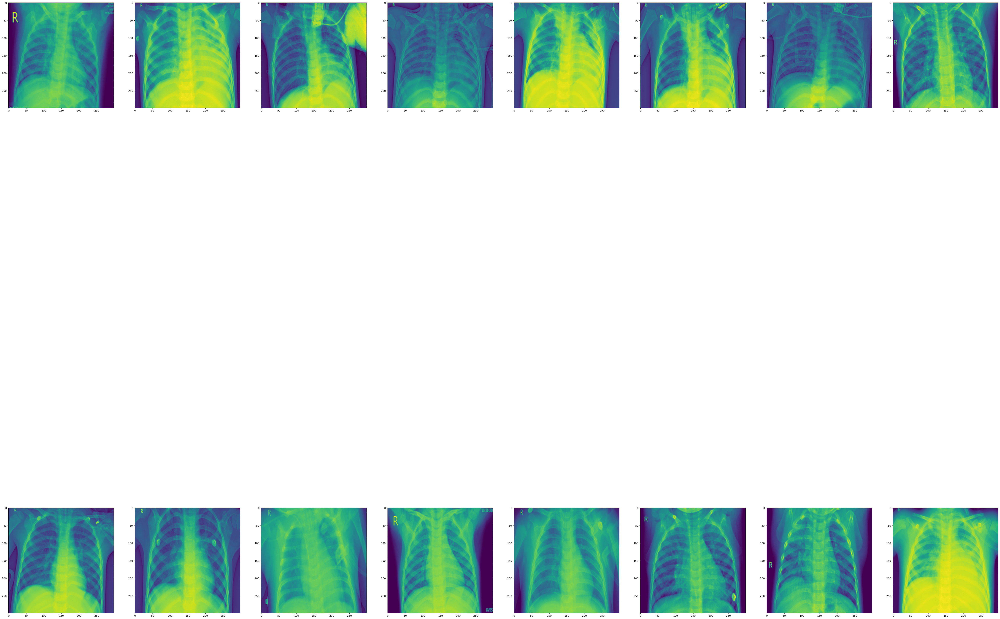

In [19]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena atau dengan status pneumonia
fig = plt.figure(figsize=(70, 66))

rows = 2 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_pneumonia_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_pneumonia_images + 1)
    images = plt.imread(pneumonia_data[multiple_pneumonia_images])
    plt.imshow(images)
    
plt.show()

## 3. Image Preprocessing

In [20]:
# Membuat variabel training dan validasi yang mencakup data-data dari variabel DataFrame (mencakup gambar per kategori)

"""
Membuat variabel baru yaitu variabel training yang mencakup
masing-masing direktori gambar x-ray per status kategori paru-paru.
Variabel/direktori training ini berfungsi untuk melatih data dengan neural networks nantinya
"""
covid19_train_dir = os.path.join(covid19_images_data)
lung_opacity_train_dir = os.path.join(lung_opacity_images_data)
normal_train_dir = os.path.join(normal_images_data)
pneumonia_train_dir = os.path.join(pneumonia_images_data)

"""
Membuat variabel baru yaitu variabel validation yang mencakup
masing-masing direktori gambar x-ray per status kategori paru-paru.
Variabel/direktori validation ini berfungsi untuk memvalidasi data setelah proses latihan dengan algoritma
"""
covid19_validation_dir = os.path.join(covid19_images_data)
lung_opacity_validation_dir = os.path.join(lung_opacity_images_data)
normal_validation_dir = os.path.join(normal_images_data)
pneumonia_validation_dir = os.path.join(pneumonia_images_data)

Fungsi dari os.path.join(nama variabel) adalah untuk menggabungkan satu/lebih komponen direktori dataset. Pada script/code diatas dapat diketahui jika variabel covid19_images_data, dll, (contoh variabel DataFrame yang digunakan untuk menampung/memanggil data gambar pada eksperimen kali ini) dipanggil dan ditampung pada sebuah variabel yang menjadi data training. Jadi akan ada 4 data training yang berisikan data-data gambar dari hasil penggabungan (join) variabel DataFrame yang berbeda-beda. Konsep tersebut sama berlakunya dengan data validation.

In [21]:
# Menggabungkan beberapa variabel DataFrame per kategori data gambar ke dalam variabel direktori dengan digabungkan menjadi satu
data_directory = [covid19_images_data, lung_opacity_images_data, normal_images_data, pneumonia_images_data]

In [22]:
"""
Membuat data training dan data testing berdasarkan keempat kategori
atau status dari data gambar x-ray paru-paru seperti covid-19, lung opacity, normal dan pneumonia
"""

# Data training
covid19_train = os.path.join(covid19_images_data)
lung_opacity_train = os.path.join(lung_opacity_images_data)
normal_lung_train = os.path.join(normal_images_data)
pneumonia_train = os.path.join(pneumonia_images_data)

# Data testing
covid19_test = os.path.join(covid19_images_data)
lung_opacity_test = os.path.join(lung_opacity_images_data)
normal_lung_test = os.path.join(normal_images_data)
pneumonia_test = os.path.join(pneumonia_images_data)

### 3.1. Splitting Images Dataset with Split Validation

In [23]:
"""
Melalukan proses pemisahan/pembagian data menjadi data training dan data testing
dengan proporsi persentase sebesar 30% untuk data testing dan 70% untuk data training
serta membuat validasi data gambar per masing-masing kategori/status paru-paru
"""

# Membuat direktori data gambar x-ray paru-paru covid-19 untuk data train dan data validation
x_train_covid19_dir, x_test_covid19_dir, y_train_covid19_dir, y_test_covid19_dir = train_test_split(
    os.listdir(covid19_train), os.listdir(covid19_test), test_size = 0.3, random_state=29)

# Membuat direktori data gambar x-ray paru-paru lung opacity untuk data train dan data validation
x_train_lung_opacity_dir, x_test_lung_opacity_dir, y_train_lung_opacity_dir, y_test_lung_opacity_dir = train_test_split(
    os.listdir(lung_opacity_train), os.listdir(lung_opacity_test), test_size = 0.3, random_state=29)

# Membuat direktori data gambar x-ray paru-paru normal untuk data train dan data validation
x_train_normal_dir, x_test_normal_dir, y_train_normal_dir, y_test_normal_dir = train_test_split(
    os.listdir(normal_lung_train), os.listdir(normal_lung_test), test_size = 0.3, random_state=29)

# Membuat direktori data gambar x-ray paru-paru pneumonia untuk data train dan data validation
x_train_pneumonia_dir, x_test_pneumonia_dir, y_train_pneumonia_dir, y_test_pneumonia_dir = train_test_split(
    os.listdir(pneumonia_train), os.listdir(pneumonia_test), test_size = 0.3, random_state=29)

Berikut adalah penjelasan dari proses split validation:

1. os.listdir(covid19_train), os.listdir(lung_opacity_train), os.listdir(normal_lung_train), os.listdir(pneumonia_train): Merupakan sebuah variabel yang memiliki status training (data untuk melatih model deep learning). Dalam pengujian kali ini, terdapat 4 variabel training yang masing-masing keempat variabel tersebut berisikan data gambar paru-paru yang terkena virus covid-19, penyakit lung opacity, penyakit pneumonia atau paru-paru normal.
2.  os.listdir(covid19_test),  os.listdir(lung_opacity_test),  os.listdir(normal_lung_test),  os.listdir(pneumonia_test): Merupakan sebuah variabel yang memiliki status testing yang berarti data-data pada variabel ini (variabel test) bertujuan untuk menguji model deep learning dengan diberikan beberapa data-data gambar baru yang sebelumnya belum diketahui oleh model. Sama seperti pada variabel training, variabel testing memiliki 4 variabel yang masing-masing keempat variabel tersebut berisikan data gambar paru-paru yang terkena virus covid-19, penyakit lung opacity, penyakit pneumonia atau paru-paru normal.
3. test_size: Nilai presentase atau nilai proporsi dalam pembagian data menjadi data training dan data testing. Dalam pengujian ini saya memakai nilai presentase test_size sebesar 0.3 yang dimana ukuran dari variabel testing mencapai 30% dan variabel train mencapai 70%.
4. random_state: Fungsi ini berfungsi untuk menetapkan nilai supaya ketika setiap kali codingan dijalankan maka nilai yang ada di data training dan data testing akan selalu tetap dan nilainya dan tidak berubah-ubah sedangkan jika di proses split validation ini tidak menetapkan nilai random_state maka setiap codingan dijalankan maka nilai baru akan teracak kembali di data training dan data testing sehingga akan memiliki nilai yang berbeda-beda setiap saat codingan dijalankan. Dalam menetapkan nilai random_state tidak ada ketentuan nilai yang pasti (bebas menentukan nilai bilangan bulat) namun dalam pengujian kali ini saya menetapkan nilai 29 di random_state.

In [24]:
"""
Menggabungkan beberapa variabel training dan testing berdasarkan
keempat kategori gambar ke dalam 1 variabel tunggal yaitu x_train, x_test, y_train, dan y_test
"""

x_train = np.concatenate((x_train_covid19_dir, x_train_lung_opacity_dir, x_train_normal_dir, x_train_pneumonia_dir), axis=0)
x_test = np.concatenate((x_test_covid19_dir, x_test_lung_opacity_dir, x_test_normal_dir, x_test_pneumonia_dir), axis=0)
y_train = np.concatenate((y_train_covid19_dir, y_train_lung_opacity_dir, y_train_normal_dir, y_train_pneumonia_dir), axis=0)
y_test = np.concatenate((y_test_covid19_dir, y_test_lung_opacity_dir, y_test_normal_dir, y_test_pneumonia_dir), axis=0)

Dari script/code diatas diketahui bahwa terdapat code np.concatenate yang berfungsi untuk menggabungkan array NumPy/beberapa variabel ke dalam 1 variabel universal yang nantinya berguna untuk tujuan pemodelan dengan suatu algoritma. Pada script diatas, saya menggunakan fungsi concatenate untuk menggabungkan beberapa variabel menjadi 4 variabel utama yaitu untuk data training adalah x_train dan y_train sedangkan data testing adalah variabel x_test dan y_test.

Variabel x_train memiliki seluruh data yang memiliki status TRAINING yang sebelumnya sudah dideklarasikan yaitu x_train_covid19_dir, x_train_lung_opacity_dir, x_train_normal_dir, x_train_pneumonia_dir yang masing-masing diisi oleh gambar dari keempat kategori x-ray paru-paru. Konsep tersebut juga berlaku pada variabel y_train, x_test dan y_test yang mana masing-masing berisikan variabel yang sudah dideklarasikan pada proses train_test_split.

Selain itu terdapat beberapa penambahan variabel universal yang digunakan pada eksperimen kali ini dimana variabel universal ini berfungsi untuk menampung/mewadahi beberapa variabel training dan testing yang dibedakan berdasarkan keempat kategori/status. Variabel-variabel universal tersebut diantaranya:
1. x_train: Merupakan data training/data yang akan melatih menggunakan model deep learning yang akan digunakan. Variabel x_train terdiri dari kumpulan dari 4 variabel independen (variabel x) yang dibedakan berdasarkan kategori/status dari gambar paru-paru dan variabel ini, variabel x_train, yang akan dilatih selama pemodelan berlangsung.
2. x_test: Merupakan data testing atau data yang akan mengetahui performa model yang telah dilatih dengan data training. Variabel x_test terdiri dari variabel independen (variabel x) yang akan diuji dengan data training. Variabel x_test juga berisikan kumpulan dari 4 variabel independen (variabel x) yang dibedakan berdasarkan kategori/status dari gambar paru-paru dan variabel ini.
3. y_train: Merupakan data training atau data yang akan melatih menggunakan model deep learning dengan fokus utamanya adalah sebagai variabel dependen/variabel y. Variabel y_train juga terdiri dari 4 kategori gambar yaitu covid-19, pneumonia, normal dan lung opacity yang nantinya berguna sebagai variabel dependen ketika proses pemodelan berlangsung
4. y_test: Merupakan data testing atau data yang akan mengetahui performa model yang telah dilatih dengan data training. Sama seperti pada variabel y_train, variabel y_test sudah pasti berbeda dengan variabel x_test karena variabel ini, variabel y_test, terdiri dari variabel dependen (variabel y) yang akan diuji selama proses pemodelan berlangsung. Variabel y_test juga terdiri dari 4 variabel gambar yaitu y_test_covid19_dir, y_test_lung_opacity_dir, y_test_normal_dir, y_test_pneumonia_dir.

In [25]:
# Melihat ukuran pada data training dan data testing yang terbagi ke dalam 2 variabel yaitu independen dan dependen

print("Ukuran pada Data Training yang terdiri dari Variabel Independen dan Variabel Dependen:", x_train.shape, y_train.shape)

print("Ukuran pada Data Testing yang terdiri dari Variabel Independen dan Variabel Dependen:", x_test.shape, y_test.shape)

Ukuran pada Data Training yang terdiri dari Variabel Independen dan Variabel Dependen: (140,) (140,)
Ukuran pada Data Testing yang terdiri dari Variabel Independen dan Variabel Dependen: (60,) (60,)


### 3.2. Data Augmentation

Augmentasi data/augmentasi gambar merupakan teknik yang sering digunakan dalam eksperimen pengklasifikasian gambar untuk meningkatkan ukuran dari kumpulan data gambar. Cara kerja secara umum proses dari augmentasi gambar adalah mengambil sampel dari kumpulan data gambar, setelah itu data sampel tersebut dimodifikasi/diubah ukurannya/pencahayannya/mengubah piksel dari gambar, dll. Selesai dari memodifikasi data maka selanjutnya data yang telah dimodifikasi akan ditambahkan ke kumpulan data aslinya sehingga dataset gambar yang dimiliki akan lebih banyak dan bervariasi.

Melakukan pemrosesan augmentasi data/augmentasi gambar dapat membantu atau bahkan menghindari permasalahan data yang kurang variasi/data yang tidak cukup, mencegah terjadinya overfitting, dan membuat algoritma dapat menghasilkan performa yang lebih baik.

Referensi:

- https://towardsdatascience.com/complete-guide-to-data-augmentation-for-computer-vision-1abe4063ad07

In [26]:
# Memasukkan image data generator ke dalam variabel training_generator & testing_generator
training_generator = tf.keras.preprocessing.image_dataset_from_directory("TestDataset",
                                                                         image_size=(48, 48),
                                                                         subset="training",
                                                                         label_mode="int",
                                                                         color_mode="rgb",
                                                                         validation_split=0.5,
                                                                         labels="inferred",
                                                                         shuffle=True,
                                                                         seed=123,
                                                                         batch_size=3)

print()

testing_generator = tf.keras.preprocessing.image_dataset_from_directory("TestDataset",
                                                                        image_size=(48, 48),
                                                                        subset="validation",
                                                                        label_mode="int",
                                                                        color_mode="rgb",
                                                                        validation_split=0.5,
                                                                        labels="inferred",
                                                                        shuffle=True,
                                                                        seed=123,
                                                                        batch_size=3)

Found 200 files belonging to 4 classes.
Using 100 files for training.

Found 200 files belonging to 4 classes.
Using 100 files for validation.


Berdasarkan dari script diatas terdapat beberapa fungsi dalam melakukan generate data gambar yang dilakukan pada eksperimen kali ini dan berikut adalah penjelasan dari fungsi-fungsi diatas:

1. image_dataset_from_directory berfungsi untuk memanggil/menghasilkan file data gambar dalam direktori folder utama yang menghasilkan kumpulan gambar dari sub-direktori atau direktori kelas yang merupakan nama sub-direktori. Untuk kasus pada eksperimen kali ini direktori folder utamanya adalah COVID-19_Radiography_Dataset dan sub-direktori/folder turunan dari folder utama adalah nama kelas/nama kategori yaitu covid-19, lung opacity, normal dan pneumonia.
2. image_size bertujuan untuk mengubah (resize) piksel gambar yang terdiri dari lebar gambar (width) dan tinggi gambar (height) yang akan digunakan pada eksperimen kali ini.
3. subset merupakan label/identitas dari gambar yang terdiri dari "training" dan "validation". Subset digunakan ketika nilai dari validation_split digunakan juga.
4. validation_split bertujuan untuk membagi jumlah data dalam proses augmentasi gambar. Pada eksperimen kali ini nilai dari validasinya adalah 0.3 atau 30%.
5. label_mode bertujuan untuk menjelaskan dari proses pengkodean dari suatu label gambar. Opsi yang digunakan pada eksperimen ini adalah int yang itu berarti label akan dikodekan sebagai bilangan bulat untuk nilai loss yaitu sparse_categorical_crossentrophy.
6. labels="inferred" merupakan label yang dihasilkan dari sub-direktori folder atau folder turunan dari folder utama atau daftar/tupel label bilangan bulat dengan ukuran yang sama dengan jumlah gambar dalam label direktori. Dalam hal ini sub-direktorinya adalah covid-19, lung opacity, normal, dan pneumonia.
7. shuffle bertujuan untuk mengacak data gambar yang ada di dalam sub-direktori pada masing-masing kelas gambar.
8. batch_size merupakan ukuran dari kumpulan data gambar yang ada di dalam direktori.

Referensi:

- https://www.tensorflow.org/api_docs/python/tf/keras/utils/image_dataset_from_directory

In [27]:
# Melihat nama-nama dari kelas yang digunakan dalam pengujian kali ini, baik dari training generator dan testing generator
class_images_train = training_generator.class_names
print(class_images_train)

class_images_test = testing_generator.class_names
print(class_images_test)

['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']
['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']


Berdasarkan hasil output diatas telah diketahui bahwa dalam pengujian kali ini kita akan mengklasifikasikan gambar berdasarkan label kelas/label kategori seperti apakah gambar tersebut teridentifikasi sebagai kategori covid 19/lung opacity/pneumonia/normal. Sesuai dengan permasalahan tersebut, hasil output diatas saya telah berhasil mengidentifikasi data gambar berdasarkan keempat kelas dan juga masing-masing telah dipisahkan dengan identitas variabel yaitu training dan validasi.

Variabel training memiliki jumlah data sebanyak 5.000 data gambar yang akan digunakan untuk melatih algoritma dengan data yang tersedia sedangkan variabel validasi menggunakan jumlah data sebanyak 2.142 data gambar yang bertujuan untuk mengujikan algoritma yang telah mempelajari data-data selama proses training dengan menggunakan data baru (dalam hal ini 2.142 data gambar merupakan data baru).

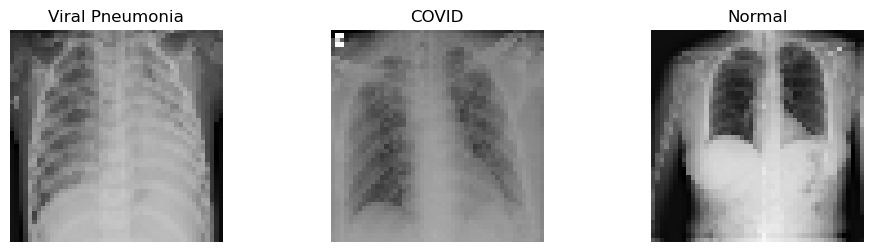

In [28]:
"""
Menampilkan gambar-gambar dari keempat kategori berdasarkan label
kelas yang telah diinisialisasikan pada proses augmentasi data gambar dari training_generator
"""
plt.figure(figsize=(20, 16))

for images, labels in training_generator.take(25):
    for i in range(3):
        ax = plt.subplot(5, 5, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_images_train[labels[i]])
        plt.axis("off")

Berdasarkan hasil diatas saya telah berhasil mengkategorikan beberapa gambar berdasarkan kelas/kategori gambarnya berdasarkan generator training. Semisal jika gambar tersebut berasal dari sub-direktori/sub-folder dari label kelas covid-19 maka gambar tersebut dikategorikan sebagai kelas covid-19. Begitu juga dengan gambar-gambar yang lain yang berasal dari sub-direktori lain seperti lung_opacity, normal, dan pneumonia.

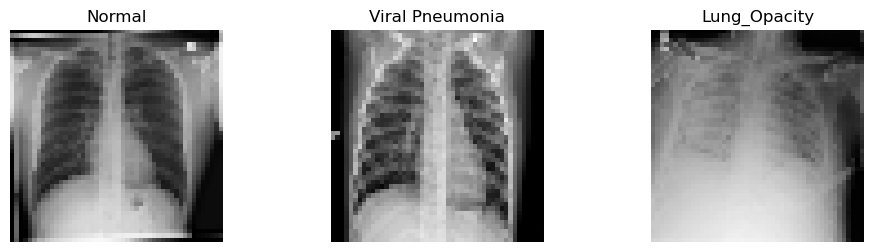

In [29]:
"""
Menampilkan gambar-gambar dari keempat kategori berdasarkan label
kelas yang telah diinisialisasikan pada proses augmentasi data gambar dari testing_generator
"""
plt.figure(figsize=(20, 16))

for images, labels in testing_generator.take(25):
    for i in range(3):
        ax = plt.subplot(5, 5, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_images_test[labels[i]])
        plt.axis("off")

Sama seperti langkah sebelumnya ketika saya melihat hasil beberapa gambar dari proses augmentasi gambar dengan training generator, hasil diatas juga telah dapat mengkategorikan beberapa gambar berdasarkan kelas/kategori gambarnya berdasarkan generator testing. Semisal jika gambar tersebut berasal dari sub-direktori/sub-folder dari label kelas covid-19 maka gambar tersebut dikategorikan sebagai kelas covid-19. Begitu juga dengan gambar-gambar yang lain yang berasal dari sub-direktori lain seperti lung_opacity, normal, dan pneumonia.

## 4. Image Modelling with ResNet Algorithm (ResNet 152 & ResNet 152 V2)

### 4.1. ResNet 152 Algorithm

In [30]:
"""
Membuat jaringan syaraf tiruan (neural networks) dengan menggunakan algoritma ResNet 152 versi 1
dari keras serta menampilkan hasil dari proses pembuatan jaringan syaraf tiruan berdasarkan algoritma ResNet 152
"""

ResNet_algorithm_152v1 = Sequential()

# Memanggil algoritma ResNet 152 versi 1 dari keras serta menginisialisasikan hyperparameter dari algoritma ResNet 152 versi 1
ResNet152_v1_network = tf.keras.applications.ResNet152(
    input_shape=(48, 48, 3),
    include_top=False,
    pooling="avg",
    weights="imagenet",
    classes=4,
)

"""
Hyperparameter yang saya gunakan dalam algoritma ResNet 152 versi 1 yang terdiri
dari 5 parameter yang berbeda yaitu input_shape, include_top, pooling, weights, dan classes.
1. input_shape berfungsi untuk dijadikan ukuran dari gambar yang akan dilatih oleh algoritma ResNet 152.
2. include_top bertujuan untuk menyertakan layer yang terhubung penuh di bagian atas layer yang dibuat.
3. pooling="avg" merupakan ekstraksi fitur/gambar menyatukan nilai rata-rata dan akan diterapkan pada
output dari blok konvolusi terakhir sehingga output dari algoritma akan menjadi tensor 2D.
4. weights="imagenet" bertujuan untuk menjadikan pre-training di ImageNet.
5. classes merupakan jumlah kelas/kategori pada dataset gambar yang bertujuan untuk mengklasifikasikan gambar
"""

ResNet_algorithm_152v1.add(ResNet152_v1_network)

ResNet_algorithm_152v1.add(Flatten())
ResNet_algorithm_152v1.add(keras.layers.BatchNormalization())

ResNet_algorithm_152v1.add(keras.layers.Dense(185, activation="relu"))

ResNet_algorithm_152v1.add(keras.layers.Dense(170, activation="relu"))
ResNet_algorithm_152v1.add(keras.layers.Dropout(0.3))

ResNet_algorithm_152v1.add(keras.layers.BatchNormalization())

ResNet_algorithm_152v1.add(keras.layers.Dense(120, activation="relu"))
ResNet_algorithm_152v1.add(keras.layers.Dropout(0.3))

ResNet_algorithm_152v1.add(keras.layers.Dense(80, activation="relu"))

ResNet_algorithm_152v1.add(keras.layers.Dense(40, activation="softmax"))
ResNet_algorithm_152v1.add(keras.layers.Dropout(0.3))

ResNet_algorithm_152v1.add(keras.layers.Dense(4, activation="softmax"))

"""
Menginisialisasikan fungsi optimasi yang akan digunakan di dalam neural networks
dan optimasi yang akan digunakan dalam pengujian kali ini adalah Adam. Optimasi Adam merupakan metode penurunan
gradien stokastik yang didasarkan pada estimasi adaptif
"""
optimizer = Adam(learning_rate=0.0001)
 
# Menyusun jaringan yang telah dibuat berdasarkan optimizer yang digunakan
ResNet_algorithm_152v1.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])

# Melihat susunan jaringan syaraf tiruan
ResNet_algorithm_152v1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152 (Functional)      (None, 2048)              58370944  
                                                                 
 flatten (Flatten)           (None, 2048)              0         
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dense (Dense)               (None, 185)               379065    
                                                                 
 dense_1 (Dense)             (None, 170)               31620     
                                                                 
 dropout (Dropout)           (None, 170)               0         
                                                        

In [31]:

history = ResNet_algorithm_152v1.fit(training_generator, validation_data = testing_generator, epochs = 10,
                                    batch_size = 5)

Epoch 1/10
34/34 [==============================] - 24s 206ms/step - loss: 1.3859 - accuracy: 0.3000 - val_loss: 1.3887 - val_accuracy: 0.2300
Epoch 2/10
34/34 [==============================] - 4s 113ms/step - loss: 1.3874 - accuracy: 0.2200 - val_loss: 1.3860 - val_accuracy: 0.2400
Epoch 3/10
34/34 [==============================] - 4s 114ms/step - loss: 1.3836 - accuracy: 0.2200 - val_loss: 1.3856 - val_accuracy: 0.2300
Epoch 4/10
34/34 [==============================] - 4s 113ms/step - loss: 1.3779 - accuracy: 0.2700 - val_loss: 1.3836 - val_accuracy: 0.2600
Epoch 5/10
34/34 [==============================] - 4s 115ms/step - loss: 1.3826 - accuracy: 0.3100 - val_loss: 1.3844 - val_accuracy: 0.2300
Epoch 6/10
34/34 [==============================] - 4s 118ms/step - loss: 1.3825 - accuracy: 0.2900 - val_loss: 1.3875 - val_accuracy: 0.2400
Epoch 7/10
34/34 [==============================] - 4s 118ms/step - loss: 1.3845 - accuracy: 0.2300 - val_loss: 1.3878 - val_accuracy: 0.2400
Epoch

In [32]:
cvd = list(covid19_data)
print(cvd[3])
# Image.open(str(cvd[3]))

TestDataset/COVID\COVID-12.png


In [33]:
image = cv2.imread(str(covid19_data[0]))
image_resized = cv2.resize(image, (48,48))
image = np.expand_dims(image_resized,axis=0)
print(image.shape)

(1, 48, 48, 3)


In [34]:
pred = ResNet152_v1_network.predict(image)
print(pred)

1/1 [==============================] - 2s 2s/step
[[0.1396626 1.9491298 1.7821358 ... 0.        3.350854  0.       ]]


In [35]:
# output_class = class_images_test[np.argmax(pred)]
# print("The predicted class is", output_class)

In [36]:
# preds = ResNet_algorithm_152v1.evaluate(training_generator, testing_generator)
# print ("Loss = " + str(preds[0]))
# print ("Test Accuracy = " + str(preds[1]))

### 4.2. ResNet 152 v2 Algorithm

In [37]:
"""
Membuat jaringan syaraf tiruan (neural networks) dengan menggunakan algoritma ResNet 152 versi 1
dari keras serta menampilkan hasil dari proses pembuatan jaringan syaraf tiruan berdasarkan algoritma ResNet 152
"""

ResNet_algorithm_152v2 = Sequential()

# Memanggil algoritma ResNet 152 versi 1 dari keras serta menginisialisasikan hyperparameter dari algoritma ResNet 152 versi 1
ResNet152_v2_network = tf.keras.applications.ResNet152V2(
    include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=(48, 48, 3),
    pooling="avg",
    classes=4,
    classifier_activation="softmax",
)
"""
Hyperparameter yang saya gunakan dalam algoritma ResNet 152 versi 1 yang terdiri
dari 5 parameter yang berbeda yaitu input_shape, include_top, pooling, weights, dan classes.
1. input_shape berfungsi untuk dijadikan ukuran dari gambar yang akan dilatih oleh algoritma ResNet 152.
2. include_top bertujuan untuk menyertakan layer yang terhubung penuh di bagian atas layer yang dibuat.
3. pooling="avg" merupakan ekstraksi fitur/gambar menyatukan nilai rata-rata dan akan diterapkan pada
output dari blok konvolusi terakhir sehingga output dari algoritma akan menjadi tensor 2D.
4. weights="imagenet" bertujuan untuk menjadikan pre-training di ImageNet.
5. classes merupakan jumlah kelas/kategori pada dataset gambar yang bertujuan untuk mengklasifikasikan gambar
"""

ResNet_algorithm_152v2.add(ResNet152_v2_network)

ResNet_algorithm_152v2.add(Flatten())
ResNet_algorithm_152v2.add(keras.layers.BatchNormalization())

ResNet_algorithm_152v2.add(keras.layers.Dense(150, activation="relu"))

ResNet_algorithm_152v2.add(keras.layers.Dense(135, activation="relu"))
ResNet_algorithm_152v2.add(keras.layers.Dropout(0.3))

ResNet_algorithm_152v2.add(keras.layers.BatchNormalization())

ResNet_algorithm_152v2.add(keras.layers.Dense(100, activation="relu"))
ResNet_algorithm_152v2.add(keras.layers.Dropout(0.3))

ResNet_algorithm_152v2.add(keras.layers.Dense(50, activation="relu"))

ResNet_algorithm_152v2.add(keras.layers.Dense(50, activation="softmax"))
ResNet_algorithm_152v2.add(keras.layers.Dropout(0.3))

ResNet_algorithm_152v2.add(keras.layers.Dense(4, activation="softmax"))

"""
Menginisialisasikan fungsi optimasi yang akan digunakan di dalam neural networks
dan optimasi yang akan digunakan dalam pengujian kali ini adalah Adam. Optimasi Adam merupakan metode penurunan
gradien stokastik yang didasarkan pada estimasi adaptif
"""
optimizer = Adam(learning_rate=0.0001)
 
# Menyusun jaringan yang telah dibuat berdasarkan optimizer yang digunakan
ResNet_algorithm_152v2.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])

# Melihat susunan jaringan syaraf tiruan
ResNet_algorithm_152v2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152v2 (Functional)    (None, 2048)              58331648  
                                                                 
 flatten_1 (Flatten)         (None, 2048)              0         
                                                                 
 batch_normalization_2 (Batc  (None, 2048)             8192      
 hNormalization)                                                 
                                                                 
 dense_6 (Dense)             (None, 150)               307350    
                                                                 
 dense_7 (Dense)             (None, 135)               20385     
                                                                 
 dropout_3 (Dropout)         (None, 135)               0         
                                                      

In [38]:
historyv2 = ResNet_algorithm_152v2.fit(training_generator, validation_data = testing_generator, epochs = 10,
                                    batch_size = 5)

Epoch 1/10
34/34 [==============================] - 20s 189ms/step - loss: 1.3830 - accuracy: 0.2400 - val_loss: 1.4018 - val_accuracy: 0.1700
Epoch 2/10
34/34 [==============================] - 4s 118ms/step - loss: 1.3850 - accuracy: 0.2600 - val_loss: 1.4013 - val_accuracy: 0.1700
Epoch 3/10
34/34 [==============================] - 4s 119ms/step - loss: 1.3893 - accuracy: 0.2600 - val_loss: 1.3965 - val_accuracy: 0.1700
Epoch 4/10
34/34 [==============================] - 4s 122ms/step - loss: 1.3802 - accuracy: 0.3000 - val_loss: 1.3894 - val_accuracy: 0.2400
Epoch 5/10
34/34 [==============================] - 4s 120ms/step - loss: 1.3828 - accuracy: 0.2700 - val_loss: 1.3815 - val_accuracy: 0.2100
Epoch 6/10
34/34 [==============================] - 4s 119ms/step - loss: 1.3803 - accuracy: 0.3700 - val_loss: 1.3735 - val_accuracy: 0.2800
Epoch 7/10
34/34 [==============================] - 4s 120ms/step - loss: 1.3785 - accuracy: 0.3600 - val_loss: 1.3756 - val_accuracy: 0.3100
Epoch

In [39]:
cvd = list(covid19_data)
print(cvd[3])
# Image.open(str(cvd[3]))

TestDataset/COVID\COVID-12.png


In [40]:
image = cv2.imread(str(covid19_data[1]))
image_resized = cv2.resize(image, (48,48))
image = np.expand_dims(image_resized,axis=0)
print(image.shape)

(1, 48, 48, 3)


In [41]:
predv2 = ResNet152_v2_network.predict(image)
print(pred)

1/1 [==============================] - 2s 2s/step
[[0.1396626 1.9491298 1.7821358 ... 0.        3.350854  0.       ]]


In [ ]:
# output_class = class_images_test[np.argmax(pred)]
# print("The predicted class is", output_class)